In [5]:
from beat_this.inference import File2Beats

In [6]:
audio_path = "../songs/Klangkarussell - Let Me Come To Life.mp3"

In [7]:
file2beats = File2Beats(checkpoint_path="final0", dbn=True)
beats, downbeats = file2beats(audio_path)

In [ ]:
import IPython.display as ipd
import librosa
import numpy as np
import soundfile as sf
import matplotlib.pyplot as plt

audio, sr = sf.read(audio_path)
# make it mono if stereo
if len(audio.shape) > 1:
  audio = np.mean(audio, axis=1)

# sonify the beats and downbeats
# remove the beats that are also downbeats for a nicer sonification
beats_for_audio = [b for b in beats if b not in downbeats]
audio_beat = librosa.clicks(times = beats_for_audio, sr=sr, click_freq=1000, length=len(audio))
audio_downbeat = librosa.clicks(times = downbeats, sr=sr, click_freq=1500, length=len(audio))

ipd.display(ipd.Audio(audio + audio_downbeat, rate=sr))

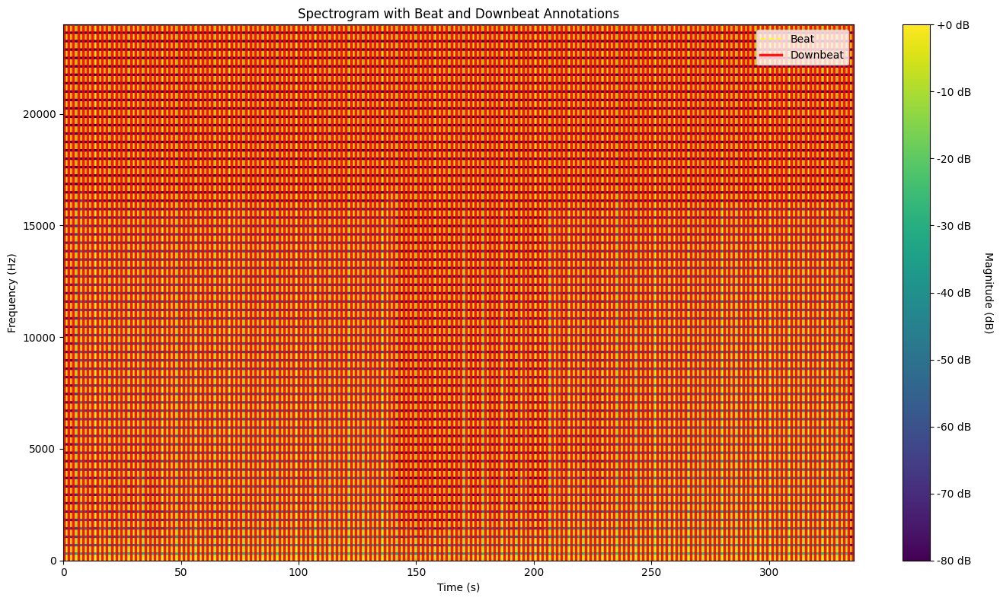

In [9]:
# Create spectrogram with beats and dB annotations
D = librosa.stft(audio)
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

# Get time axis
times = librosa.frames_to_time(np.arange(S_db.shape[1]), sr=sr)

# Create the plot
fig, ax = plt.subplots(figsize=(14, 8))

# Display spectrogram
img = ax.imshow(S_db, aspect='auto', origin='lower', 
                extent=[times[0], times[-1], 0, sr//2],
                cmap='viridis', interpolation='bilinear')

# Add beat markers (vertical lines)
for beat_time in beats:
    ax.axvline(x=beat_time, color='yellow', linestyle='--', linewidth=1.5, alpha=0.7, label='Beat' if beat_time == beats[0] else '')

# Add downbeat markers (thicker vertical lines)
for downbeat_time in downbeats:
    ax.axvline(x=downbeat_time, color='red', linestyle='-', linewidth=2.5, alpha=0.9, label='Downbeat' if downbeat_time == downbeats[0] else '')

# Add colorbar with dB scale
cbar = plt.colorbar(img, ax=ax, format='%+2.0f dB')
cbar.set_label('Magnitude (dB)', rotation=270, labelpad=20)

# Labels and title
ax.set_xlabel('Time (s)')
ax.set_ylabel('Frequency (Hz)')
ax.set_title('Spectrogram with Beat and Downbeat Annotations')
ax.legend(loc='upper right')

plt.tight_layout()
plt.show()
